## Assignment 2 (OPTION 2)

##### CID: 01731821

##### Google Colab notebook link: [Google Colab Notebook](https://colab.research.google.com/drive/1KoBHanRFmypQOk3P4dJ__OF9qrrdtedR?usp=sharing)

### OPTION 2: A DeepDream-like model

Before starting any of the questions, we need to import the required libraries.

In [1]:
# Import necessary libraries
import numpy as np
import pandas as pd
import torch
import torchvision
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
import torch.optim as optim
import torch.nn as nn
import torch.nn.functional as F
from torchvision import models
from tqdm.notebook import tqdm # for progress bar in jupyter notebook (pip install tqdm)

In [2]:
# Set seed for reproducibility
SEED = 1731821
np.random.seed(SEED)
torch.manual_seed(SEED)
print("Seed set to", SEED)

Seed set to 1731821


In [3]:
# Small interactive function to check if GPU is available and if so, use it
status = input("Using GPU improves the code speed by 5x. Do you want to use GPU for training? (y/n) ")
if torch.cuda.is_available() and status == "y":
    device = torch.device("cuda")
elif not torch.cuda.is_available() and status == "y":
    status = input("You do not seem to have a CUDA-enabled GPU. Do you have M1 Mac (y/n) ")
    if status == "y":
        device = torch.device("mps")
    else:
        device = torch.device("cpu")
else:
    device = torch.device("cpu")
print("Using device:", device)

Using device: mps


> This is just a small interaction with the user to make sure that if the user wants to use the GPU, then they can do so. If the user wants to use the CPU, then they can also do so but it would be much slower. Please note that it is also possible to use the GPU on a M1 Mac, if the latest pytorch-nightly is installed.
> Using GPU is recommended as it is on average 5 times faster than using the CPU.

### Part 1: A convolutional neural network, dropout and batch-norm

The CIFAR10 dataset is a collection of 32x32 colour images in 10 classes. Our goal is to train a CNN to accurately classify these images.

To implement a CNN, we will use convolutional layers to extract features from the input images, followed by fully connected layers to classify the images. Dropout and batch normalisation are common techniques used to improve the performance of CNNs and we will also make use of them in this assignment.

To train the CNN, we first load the CIFAR10 dataset and split it into training and test sets. We then define the CNN architecture using PyTorch's nn.Module class. We typically use convolutional layers followed by pooling layers to downsample the feature maps, and fully connected layers to classify the images. We will also add dropout and batch normalisation layers to improve the performance of the CNN in the later questions.

After defining the CNN architecture, we train it on the training set using a cross-entropy loss function and an Stochastic Gradient Descent (SGD) optimiser. We train the CNN for multiple epochs and evaluate its performance on the test set after each epoch. The goal is to achieve a test accuracy of over 60%, which seems to be a reasonable benchmark for the CIFAR10 dataset as we have 10 classes.

Overall, implementing and training a CNN for the CIFAR10 dataset involves choosing an appropriate architecture, applying techniques such as dropout and batch normalisation to improve performance, and optimising the CNN using an appropriate loss function and optimiser. We will try to achieve this in the following questions.

#### Task 1: Implement and train a CNN

We first load the CIFAR10 dataset using a batch size of 32 as it is good practice to use a batch size that is a power of 2. Moreover, 32 is a good compromise between memory usage, speed and accuracy.

In [4]:
transform = transforms.Compose(
    [transforms.ToTensor(),
     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

batch_size = 32

trainset = torchvision.datasets.CIFAR10(root='./data', train=True,
                                        download=True, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size,
                                          shuffle=True)

testset = torchvision.datasets.CIFAR10(root='./data', train=False,
                                       download=True, transform=transform)
testloader = torch.utils.data.DataLoader(testset, batch_size=batch_size,
                                         shuffle=False)

# Faster training with less memory as explained in the lectures following Assignment 1
trainloader = list(trainloader)
testloader = list(testloader)

classes = ('plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck')

Files already downloaded and verified
Files already downloaded and verified


> Note that we have transformed the trainload and testloader objects into lists using ```trainloader = list(trainloader)``` and ```testloader = list(testloader)```. This is because as we have seen in the lectures and the tutorial following Assignement 1, this transformations seems to be a good practice to make our processes faster.

We can now check similarly as in the tutorial in Week 7 the effect of the convolution on a random image of our dataset. In addition of showing the effect of the convolution on the image, we can also check that our images are correctly loaded.

In [5]:
# get some random training images; this will load a set of images of size batchsize 
dataiter = iter(trainloader)
images, labels = next(dataiter)
img = images[0] # take just the first image; the above thing is an array of images of size batchsize
img = img / 2 + 0.5 # unnormalize

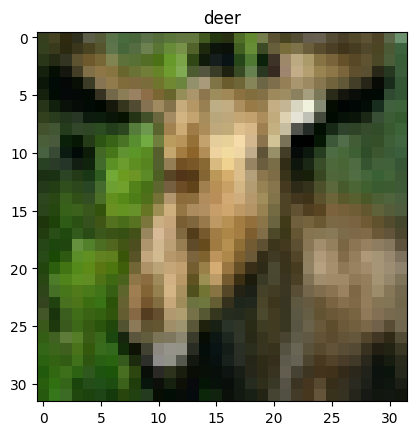

In [6]:
# Print the original image
npimg = img.numpy() # translate to numpy
npimg_t = np.transpose(npimg, (1, 2, 0))
plt.imshow(npimg_t)
plt.title(str(classes[labels[0]]))
plt.show()

In [7]:
def convolution2d(image, kernel):
    m, n = kernel.shape
    if (m == n):
        y, x = image.shape
        y = y - m + 1
        x = x - m + 1
        new_image = np.zeros((y,x))
        for i in range(y):
            for j in range(x):
                new_image[i][j] = np.sum(image[i:i+m, j:j+m]*kernel) 
    return new_image

(32, 32, 3)


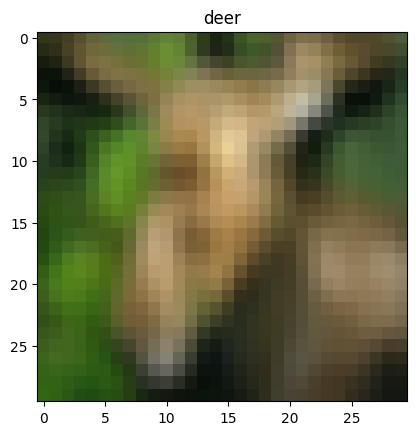

In [8]:
print(npimg_t.shape)
# Let's apply a convolution per each 'channel' of the input with a blurring kernel
K = np.array([[0.1111, 0.1111, 0.1111],
         [0.1111, 0.1111, 0.1111],
         [0.1111, 0.1111, 0.1111]])
npimg_conv1 = np.zeros([30,30,3])
for it in range(npimg_t.shape[2]):
    npimg_conv1[:,:,it] = convolution2d(npimg_t[:,:,it], K)
plt.imshow(npimg_conv1)
plt.title(str(classes[labels[0]]))
plt.show()

> Similarly as in the Week 7 tutorial, we observe that the convoluted image is blurred, as we could have expected. Furthermore, we can see that the image is correctly loaded.

We will make use of a similar architecture as the one used in the tutorial of Week 7 for building our CNN model. However, we slightly modify it as we want to be able to use dropout and batch normalisation in the later questions and therefore we only use 3 convolutional layers instead of 4. This will also allow us to train and test our model faster.

In other words, we will use the following architecture. Let x be the input:
1. The input goes into a convolutional layer with 3 input channels, 64 output channels and kernel of size 3x3 followed by a ReLU activation + pooling layer 
2. The output from the previous operation goes into another convolutional layer with 64 input channels, 128 output channels and a kernel of size 3x3 followed by a ReLU + pooling
3. The output from the previous operation goes into another convolutional layer with 128 input channels, 256 output channels and a kernel of size 3x3 followed by a ReLU
4. Then there will be a Flatten layer
5. Then there will be two linear layers + ReLU's and a final linear layer. 


In [9]:
# Code for the convolutional neural network extracted from the Week 7 Tutorial about CNNs
# Note that we have slightly modified the network to have 3 convolutional layers instead of 4
# This is to speed up training and make it more manageable for our assignment

class Net(nn.Module):
    """ A simple CNN with 3 convolutional layers and 3 fully connected layers """
    # in the init function we will just define several layers that we can later use
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        #self.conv4 = nn.Conv2d(256, 256, 3) # modified to 3 conv layers for faster training
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(4096, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)

    # here we define the forward pass, i.e. how our input x is modified as it moves through the network
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        x = F.relu(self.conv3(x))
        #x = F.relu(self.conv4(x)) # modified to 3 conv layers for faster training
        x = torch.flatten(x, 1)
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    
    # let's also define a method to access a layer of choice's output; we will use this later
    def forward_partial(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        return x # you can change the partial forward pass to obtain arbitrary layers' output

net = Net()
net.to(device)

Net(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
)

In [10]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

nr_epochs = 25 # the number of times we iterate over our dataset

for epoch in tqdm(range(1,nr_epochs+1)):
    train_loss = 0
    correct_train = 0
    total_train = 0
    test_loss = 0
    correct = 0
    total = 0
    # Iterate over the training set
    for i, (images, labels) in enumerate(trainloader, 0):
        # get the inputs
        images, labels = images.to(device), labels.to(device)
        # zero the parameter gradients
        optimizer.zero_grad()
        # Compute the output for all the images in the batch_size;
        outputs = net(images)
        # Compute the loss value
        loss = criterion(outputs, labels)
        # Compute the gradients
        loss.backward()
        # Take the optimisation step
        optimizer.step()
        # Compute the error
        _, predicted = outputs.max(1) # argmax() function modified to max() as explained on an edStem forum post: https://edstem.org/us/courses/32063/discussion/2796531
        correct_train += (predicted == labels).sum().item()
        total_train += labels.size(0)
        # Compute the loss
        train_loss += loss.item()
    
    # Compute the average loss and error over the test set
    for i, (images, labels) in enumerate(testloader, 0):
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        loss = criterion(outputs, labels)
        test_loss += loss.item()
        _, predicted = outputs.max(1)
        correct += (predicted == labels).sum().item()
        total += labels.size(0)

    # Compute the average loss and error over the training set and test set
    train_loss /= len(trainloader)
    train_error = 1 - correct_train / total_train
    test_loss /= len(testloader)
    test_error = 1 - correct / total
    print(f"Epoch: {epoch:03} | Train Loss: {loss.item():.4f} | Test Loss: {test_loss:.4f} | Train Accuracy: {100*(1-train_error):.2f}% | Test Accuracy: {100*(1-test_error):.2f}%")
    

print('Finished Training')

correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs; therefore there
# is no need to store the computational graph in between
with torch.no_grad():
    for (images, labels) in testloader: #iterate over all the test images
        images, labels = images.to(device), labels.to(device)
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        # compute the total number of images processed by adding the number of images in each batch
        total += labels.size(0) 
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the test images: {100 * (correct / total):.4} %')

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch: 001 | Train Loss: 1.7252 | Test Loss: 2.0127 | Train Accuracy: 15.95% | Test Accuracy: 24.01%
Epoch: 002 | Train Loss: 1.3739 | Test Loss: 1.6050 | Train Accuracy: 33.65% | Test Accuracy: 39.75%
Epoch: 003 | Train Loss: 1.1925 | Test Loss: 1.4253 | Train Accuracy: 43.59% | Test Accuracy: 47.59%
Epoch: 004 | Train Loss: 1.0431 | Test Loss: 1.3114 | Train Accuracy: 49.65% | Test Accuracy: 52.07%
Epoch: 005 | Train Loss: 0.9095 | Test Loss: 1.2082 | Train Accuracy: 54.12% | Test Accuracy: 56.42%
Epoch: 006 | Train Loss: 0.8223 | Test Loss: 1.1096 | Train Accuracy: 58.33% | Test Accuracy: 60.35%
Epoch: 007 | Train Loss: 0.8761 | Test Loss: 1.0311 | Train Accuracy: 62.18% | Test Accuracy: 63.54%
Epoch: 008 | Train Loss: 0.9631 | Test Loss: 0.9616 | Train Accuracy: 65.43% | Test Accuracy: 66.04%
Epoch: 009 | Train Loss: 0.9847 | Test Loss: 0.9062 | Train Accuracy: 68.18% | Test Accuracy: 68.24%
Epoch: 010 | Train Loss: 0.9887 | Test Loss: 0.8640 | Train Accuracy: 70.83% | Test Accurac

Overall, our first CNN model achieves to have a very good train and test accuracy around 95% and 71% respectively. This is a good start as it is shows that is able to correctly classify the images of the CIFAR10 dataset.

However, we notice that our model achieves a very good accuracy on the training set, but a much lower accuracy on the test set. This is a clear sign of overfitting. We will try to improve the performance of our model and in particular its generalization error in the next questions.

#### Task 2: Dropout

Dropout is a regularization technique used to prevent overfitting in neural networks and in particular in CNN. It works by randomly dropping out (i.e., setting to zero) some of the neurons in the neural network during training, forcing the network to learn redundant representations of the input data. Dropout is usually applied to fully connected layers and can be thought of as a way to create an ensemble of neural networks that share weights, but have different random subsets of neurons active at each training iteration.

In PyTorch, we can add dropout layers to our model using the ``torch.nn.Dropout`` class. We can specify the probability of dropping out a neuron using the p argument, which is usually set to a value between 0.2 and 0.5. After multiple tests, we noticed that $p=0.2$ is the best p in our case. We can then add the dropout layer to our model's forward pass.

When we add dropout to our CNN model for CIFAR10, we observe that the test accuracy improves and the model generalizes better to unseen data. Dropout helps to prevent overfitting by forcing the model to learn more robust and redundant features. However, the location where we place the dropout layer can affect the performance of the model. If we place the dropout layer too early in the network, it may prevent the model from learning useful representations of the input data. On the other hand, if we place the dropout layer too late in the network, it may not have a significant effect on the performance of the model. The optimal location for the dropout layer depends on the specific architecture of the network and the task at hand.

In our case, after multiple trainings in which we changed the location of the dropout, we chose to place two dropout layers before the two linear layers. These locations gave us the best results. In fact, when placing the dropout layers earlier, our model was losing accuracy by not learning some essential features. 

Overall, dropout forces the network to learn redundant representations and therefore improves its generalization error. We will now add dropout to our CNN model and see that it improves its performance.

In [11]:
# Similar architecture as the one above, but with 2 dropout layers
class Net_Dropout(nn.Module):
    # in the init function we will just define several layers that we can later use
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        #self.conv4 = nn.Conv2d(256, 256, 3) 
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(4096, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)
        self.dropout1 = nn.Dropout(p=0.2)
        self.dropout2 = nn.Dropout(p=0.2)

    # here we define the forward pass, i.e. how our input x is modified as it moves through the network
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        x = F.relu(self.conv3(x))
        #x = F.relu(self.conv4(x))
        x = torch.flatten(x, 1)
        x = self.dropout1(x)
        x = F.relu(self.fc1(x))
        x = self.dropout2(x)
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    
    # let's also define a method to access a layer of choice's output; we will use this later
    def forward_partial(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        return x # you can change the partial forward pass to obtain arbitrary layers' output

net = Net_Dropout()
net.to(device)

Net_Dropout(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
  (dropout1): Dropout(p=0.2, inplace=False)
  (dropout2): Dropout(p=0.2, inplace=False)
)

> As mentionned earlier, the location of our dropout layers can play a big role in the performance of our model. We have chosen to add dropout layers before the two linear layers. This is because we want to drop out some of the neurons in the fully connected layers. However, we do not want to drop out the neurons in the pooling layers as we want to keep the information that they provide.

In [12]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

nr_epochs = 25 # the number of times we iterate over our dataset

for epoch in tqdm(range(1,nr_epochs+1)):
    train_loss = 0
    correct_train = 0
    total_train = 0
    test_loss = 0
    correct = 0
    total = 0
    # Iterate over the training set
    for i, (images, labels) in enumerate(trainloader, 0):
        # get the inputs
        images, labels = images.to(device), labels.to(device)
        # zero the parameter gradients
        optimizer.zero_grad()
        # Compute the output for all the images in the batch_size;
        outputs = net(images)
        # Compute the loss value
        loss = criterion(outputs, labels)
        # Compute the gradients
        loss.backward()
        # Take the optimisation step
        optimizer.step()
        # Compute the error
        _, predicted = outputs.max(1)
        correct_train += (predicted == labels).sum().item()
        total_train += labels.size(0)
        # Compute the loss
        train_loss += loss.item()
    
    # Compute the average loss and error over the test set
    for i, (images, labels) in enumerate(testloader, 0):
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        loss = criterion(outputs, labels)
        test_loss += loss.item()
        _, predicted = outputs.max(1)
        correct += (predicted == labels).sum().item()
        total += labels.size(0)

    # Compute the average loss and error over the training set and test set
    train_loss /= len(trainloader)
    train_error = 1 - correct_train / total_train
    test_loss /= len(testloader)
    test_error = 1 - correct / total
    print(f"Epoch: {epoch:03} | Train Loss: {loss.item():.4f} | Test Loss: {test_loss:.4f} | Train Accuracy: {100*(1-train_error):.2f}% | Test Accuracy: {100*(1-test_error):.2f}%")
    

print('Finished Training')

correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs; therefore there
# is no need to store the computational graph in between
with torch.no_grad():
    for (images, labels) in testloader: #iterate over all the test images
        images, labels = images.to(device), labels.to(device)
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        # compute the total number of images processed by adding the number of images in each batch
        total += labels.size(0) 
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the test images: {100 * (correct / total):.4} %')

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch: 001 | Train Loss: 1.7906 | Test Loss: 2.0392 | Train Accuracy: 16.14% | Test Accuracy: 22.42%
Epoch: 002 | Train Loss: 1.4285 | Test Loss: 1.6762 | Train Accuracy: 31.45% | Test Accuracy: 36.46%
Epoch: 003 | Train Loss: 1.2078 | Test Loss: 1.4955 | Train Accuracy: 40.78% | Test Accuracy: 44.94%
Epoch: 004 | Train Loss: 1.1465 | Test Loss: 1.3648 | Train Accuracy: 47.31% | Test Accuracy: 50.00%
Epoch: 005 | Train Loss: 1.0104 | Test Loss: 1.2579 | Train Accuracy: 52.23% | Test Accuracy: 54.43%
Epoch: 006 | Train Loss: 1.0690 | Test Loss: 1.1829 | Train Accuracy: 56.13% | Test Accuracy: 57.41%
Epoch: 007 | Train Loss: 0.9059 | Test Loss: 1.1016 | Train Accuracy: 59.26% | Test Accuracy: 60.57%
Epoch: 008 | Train Loss: 0.9714 | Test Loss: 1.0331 | Train Accuracy: 62.25% | Test Accuracy: 63.47%
Epoch: 009 | Train Loss: 0.7947 | Test Loss: 0.9776 | Train Accuracy: 64.85% | Test Accuracy: 65.70%
Epoch: 010 | Train Loss: 0.8223 | Test Loss: 0.9307 | Train Accuracy: 67.52% | Test Accurac

In [17]:
# Create table of the results with and without dropout
results = pd.DataFrame(columns=['Model', 'Train Loss', 'Test Loss', 'Train Accuracy', 'Test Accuracy', 'Generalization Gap'])
results.loc[0] = ['No Dropout', 0.8242, 1.2821, 94.11, 71.42, 22.69]
results.loc[1] = ['Dropout', 0.5684, 0.8988, 87.55, 73.77, 13.78]
results

,Model,Train Loss,Test Loss,Train Accuracy,Test Accuracy,Generalization Gap
0,No Dropout,0.8242,1.2821,94.11,71.42,22.69
1,Dropout,0.5684,0.8988,87.55,73.77,13.78


We have successfully improved the performance of our CNN model by adding dropout layers. Indeed, we have achieved to increase our test accuracy by more than 2%. Moreover, it seems like our model generalizes better to unseen data as we can see that the gap between the train and test accuracy is smaller than before. This is a clear sign that our model is less overfitting to our training data. This is a good sign as we want our model to be able to generalize well to unseen data!

We can now try to improve the performance of our model by adding batch normalisation.

#### Task 3: BatchNorm

Finally, we will make use of Batch normalization in order to improve the performance of our CNN model. In fact, batch normalization (BatchNorm) is a technique used to normalize the input of a neural network by transforming the input data to have zero mean and unit variance. This technique is applied to the output of a layer and is usually applied before a non-linear activation function. BatchNorm helps to address the internal covariate shift problem, which is the problem of the distribution of each layer's inputs changing during training. By normalizing the input, BatchNorm helps to stabilize the training process, reduce the dependence on the initialization of the weights, and improve the performance of the network. When we add BatchNorm to our model, we observe that the test accuracy improves. BatchNorm helps to accelerate the training process, reduce overfitting, and improve the performance of the model. Combined with dropout, we will make use of BatchNorm to improve the performance of our CNN model.

In PyTorch, we can add BatchNorm layers to our model using the ``torch.nn.BatchNorm2d`` class, which applies BatchNorm to the output of 2D convolutional layers. We can add BatchNorm layers to our CNN model for CIFAR10, usually after the convolutional layer and before the activation function. The location of BatchNorm in a neural network is important because it affects the statistics that are used to normalize the input of each layer. If we place BatchNorm after the activation function, then the normalization would be applied to the output of the activation function, which can change the distribution of the input to the next layer. This can make it more difficult for the network to learn useful representations of the input data. On the other hand, if we place BatchNorm before the activation function, then the normalization is applied to the input of the activation function, which can help to ensure that the input to the activation function has zero mean and unit variance. This can help to stabilize the training process, improve the performance of the network, and reduce the dependence on the initialization of the weights. Therefore, the location of BatchNorm in a neural network is important because it affects the statistics used to normalize the input of each layer.


After multiple testing, we noticed that adding BatchNorm after the second convolutional layer and before its ReLU activation function is the best location for our BatchNorm layers.


Overall, adding BatchNorm to our CNN model for CIFAR10 is a powerful technique that can significantly improve the performance of the model. Combining BatchNorm with dropout can further improve the performance of the model and prevent overfitting.

In [14]:
class Net_Dropout_BN(nn.Module):
    # in the init function we will just define several layers that we can later use
    def __init__(self):
        super().__init__()
        self.conv1 = nn.Conv2d(3, 64, 3) 
        self.conv2 = nn.Conv2d(64, 128, 3) 
        self.conv3 = nn.Conv2d(128, 256, 3) 
        #self.conv4 = nn.Conv2d(256, 256, 3) # modified to 3 conv layers for faster training
        self.pool = nn.MaxPool2d(2, stride=2)
        self.fc1 = nn.Linear(4096, 120)
        self.fc2 = nn.Linear(120, 84)
        self.fc3 = nn.Linear(84, 10)
        self.dropout1 = nn.Dropout(p=0.2)
        self.dropout2 = nn.Dropout(p=0.2)
        self.batchnorm1 = nn.BatchNorm2d(128)

    # here we define the forward pass, i.e. how our input x is modified as it moves through the network
    def forward(self, x):
        x = self.pool(F.relu(self.conv1(x)))
        x = self.pool(F.relu(self.batchnorm1(self.conv2(x))))
        x = F.relu(self.conv3(x))
        #x = F.relu(self.conv4(x)) # modified to 3 conv layers for faster training
        x = torch.flatten(x, 1)
        x = self.dropout1(x)
        x = F.relu(self.fc1(x))
        x = self.dropout2(x)
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x
    
    # let's also define a method to access a layer of choice's output; we will use this later
    def forward_partial(self, x):
        x = self.pool(F.relu(self.conv1(x))) 
        x = self.pool(F.relu(self.conv2(x))) 
        return x # you can change the partial forward pass to obtain arbitrary layers' output

net = Net_Dropout_BN()
net.to(device)

Net_Dropout_BN(
  (conv1): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (conv3): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=4096, out_features=120, bias=True)
  (fc2): Linear(in_features=120, out_features=84, bias=True)
  (fc3): Linear(in_features=84, out_features=10, bias=True)
  (dropout1): Dropout(p=0.2, inplace=False)
  (dropout2): Dropout(p=0.2, inplace=False)
  (batchnorm1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)

> We have used the same architecture from the previous question but we have added an additional BatchNorm layer after the second convolutional layer.

In [15]:
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(net.parameters(), lr=0.001, momentum=0.9)

nr_epochs = 25 # the number of times we iterate over our dataset

for epoch in tqdm(range(1,nr_epochs+1)):
    train_loss = 0
    correct_train = 0
    total_train = 0
    test_loss = 0
    correct = 0
    total = 0
    # Iterate over the training set
    for i, (images, labels) in enumerate(trainloader, 0):
        # get the inputs
        images, labels = images.to(device), labels.to(device)
        # zero the parameter gradients
        optimizer.zero_grad()
        # Compute the output for all the images in the batch_size;
        outputs = net(images)
        # Compute the loss value
        loss = criterion(outputs, labels)
        # Compute the gradients
        loss.backward()
        # Take the optimisation step
        optimizer.step()
        # Compute the error
        _ , predicted = outputs.max(1) 
        correct_train += (predicted == labels).sum().item()
        total_train += labels.size(0)
        # Compute the loss
        train_loss += loss.item()
    
    # Compute the average loss and error over the test set
    for i, (images, labels) in enumerate(testloader, 0):
        images, labels = images.to(device), labels.to(device)
        outputs = net(images)
        loss = criterion(outputs, labels)
        test_loss += loss.item()
        _, predicted = outputs.max(1)
        correct += (predicted == labels).sum().item()
        total += labels.size(0)

    # Compute the average loss and error over the training set and test set
    train_loss /= len(trainloader)
    train_error = 1 - correct_train / total_train
    test_loss /= len(testloader)
    test_error = 1 - correct / total
    print(f"Epoch: {epoch:03} | Train Loss: {loss.item():.4f} | Test Loss: {test_loss:.4f} | Train Accuracy: {100*(1-train_error):.2f}% | Test Accuracy: {100*(1-test_error):.2f}%")
    

print('Finished Training')

correct = 0
total = 0
# since we're not training, we don't need to calculate the gradients for our outputs; therefore there
# is no need to store the computational graph in between
with torch.no_grad():
    for (images, labels) in testloader: #iterate over all the test images
        images, labels = images.to(device), labels.to(device)
        # calculate outputs by running images through the network
        outputs = net(images)
        # the class with the highest energy is what we choose as prediction
        _, predicted = torch.max(outputs.data, 1)
        # compute the total number of images processed by adding the number of images in each batch
        total += labels.size(0) 
        correct += (predicted == labels).sum().item()

print(f'Accuracy of the network on the test images: {100 * (correct / total):.4} %')

  0%|          | 0/25 [00:00<?, ?it/s]

Epoch: 001 | Train Loss: 1.2647 | Test Loss: 1.3690 | Train Accuracy: 37.17% | Test Accuracy: 49.63%
Epoch: 002 | Train Loss: 1.1077 | Test Loss: 1.1199 | Train Accuracy: 55.79% | Test Accuracy: 60.23%
Epoch: 003 | Train Loss: 1.0599 | Test Loss: 0.9918 | Train Accuracy: 62.92% | Test Accuracy: 64.75%
Epoch: 004 | Train Loss: 0.9517 | Test Loss: 0.9023 | Train Accuracy: 67.94% | Test Accuracy: 68.47%
Epoch: 005 | Train Loss: 1.1927 | Test Loss: 0.8721 | Train Accuracy: 71.12% | Test Accuracy: 69.84%
Epoch: 006 | Train Loss: 0.7282 | Test Loss: 0.8492 | Train Accuracy: 73.83% | Test Accuracy: 70.65%
Epoch: 007 | Train Loss: 1.2657 | Test Loss: 0.8187 | Train Accuracy: 75.92% | Test Accuracy: 72.34%
Epoch: 008 | Train Loss: 0.9781 | Test Loss: 0.8080 | Train Accuracy: 77.78% | Test Accuracy: 72.68%
Epoch: 009 | Train Loss: 1.2341 | Test Loss: 0.7730 | Train Accuracy: 79.65% | Test Accuracy: 74.28%
Epoch: 010 | Train Loss: 0.9283 | Test Loss: 0.8083 | Train Accuracy: 81.19% | Test Accurac

In [16]:
# Create table of the results for comparison
results = pd.DataFrame(columns=['Model', 'Train Loss', 'Test Loss', 'Train Accuracy', 'Test Accuracy', 'Generalization Gap'])
results.loc[0] = ['No Dropout', 0.8242, 1.2821, 94.11, 71.42, 22.69]
results.loc[1] = ['Dropout', 0.5684, 0.8988, 87.55, 73.77, 13.78]
results.loc[2] = ['Dropout + BatchNorm', 0.7039, 1.0637, 94.07, 74.93, 18.80]
results

,Model,Train Loss,Test Loss,Train Accuracy,Test Accuracy,Generalization Gap
0,No Dropout,0.8242,1.2821,94.11,71.42,22.69
1,Dropout,0.5684,0.8988,87.55,73.77,13.78
2,Dropout + BatchNorm,0.7039,1.0637,94.07,74.93,18.80


Using BatchNorm in addition to dropout layers, we have successfully achieved to increase our test accuracy by more than 1%.  Moreover, we can see that the model is learning more quickly the essential features of our dataset. The test accuracy increases faster than before. However, we can also observe that our generalization error gap is still quite big. This is a clear sign that our model is still overfitting to our training data and that potentially it could be improved further by adding more dropout layers or by changing slightly the architecture of our model.

### Part 2: The DeepDream method

The DeepDream method is a technique for visualizing the features learned by a neural network by enhancing the input image to produce a visually striking representation of the learned features. The basic idea is to take an input image and pass it through a pre-trained neural network, such as Inception-V3, in order to obtain the activation outputs from a certain layer. Then, we apply a gradient ascent method to the input image in order to maximize the values of the activation, effectively enhancing the image with what the neural network "likes" to see.

The gradient ascent method used in DeepDream is essentially an optimization technique that iteratively updates the input image to maximize a certain objective function. In this case, the objective function is the norm of the activations over a certain layer of the neural network. By maximizing this objective function, we are effectively enhancing the image with the patterns and textures that the neural network has learned to recognize at that layer.

The DeepDream method can be used to generate visually striking images that reveal the inner workings of the neural network, such as the features it has learned to recognize at different layers. This technique can also be used to generate interesting and artistic images by starting with a random or abstract input image, and then iteratively enhancing it with the patterns and textures learned by the neural network.

#### Task 1: Load an image

Our first task is to correctly load an image using the ``PIL`` library. We will use the ``PIL.Image.open`` function to load the image. We will then use a preprocessing pipeline function in order to resize and normalize our image to the correct dimensions and values. We will then use the ``IPython.display.display`` function to display the image in the notebook.

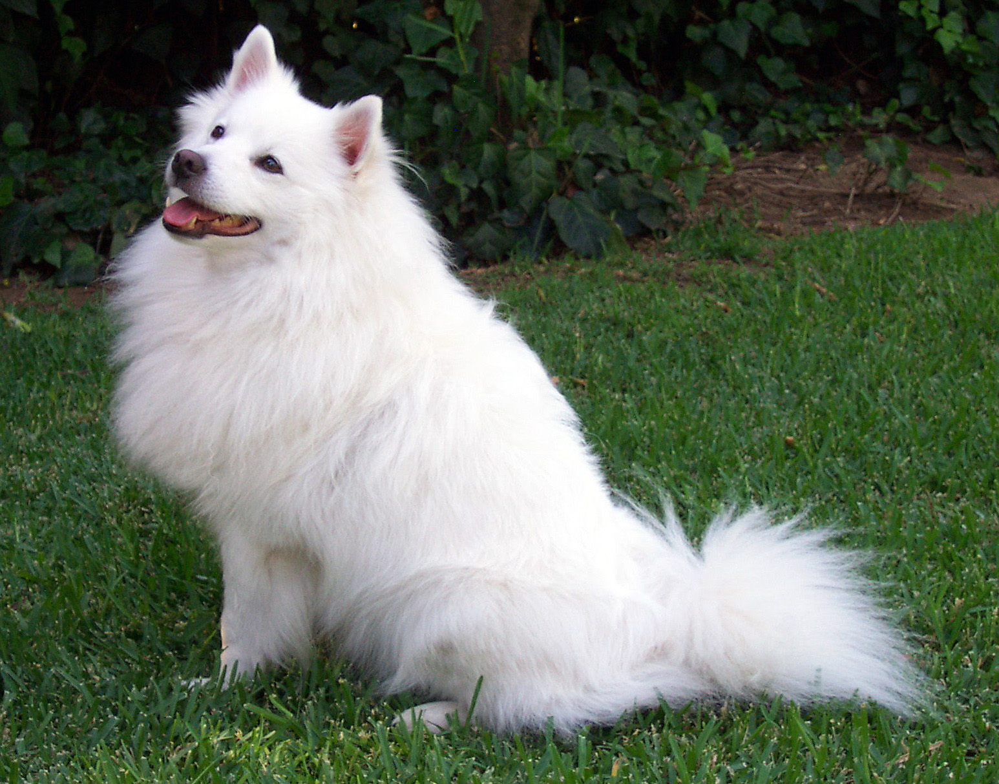

'Initial image'

In [19]:
import urllib
url, filename = ("https://github.com/pytorch/hub/raw/master/images/dog.jpg", "dog.jpg")

try: urllib.URLopener().retrieve(url, filename)
except: urllib.request.urlretrieve(url, filename)

# sample execution (requires torchvision)
from PIL import Image
from torchvision import transforms
import IPython.display as display
input_image = Image.open(filename)
preprocess = transforms.Compose([
    transforms.Resize(299),
    transforms.CenterCrop(299),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

input_tensor = preprocess(input_image)
input_tensor = input_tensor.to(device) # move the input to GPU for speed if available
input_batch = input_tensor.unsqueeze(0) # create a mini-batch as expected by the model

# Print inital image using PIL for bigger images
display.display(Image.fromarray(np.array(input_image)), 'Initial image')

> Note that we use the ``IPython.display.display`` function to display the image in the notebook. This function allows us to show the image in the notebook with a nice format.

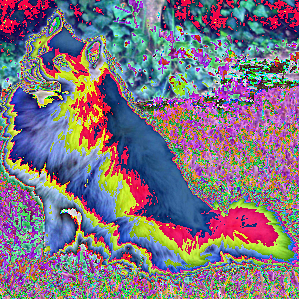

'Transformed image'

In [20]:
# Print transformed image using PIL for bigger images
output_img = transforms.ToPILImage()(input_batch.squeeze(0))  
display.display(output_img, 'Transformed image')

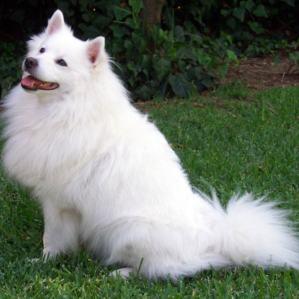

'Unnormalized image'

In [21]:
# Print unnormalized image
numpy_image = input_batch.cpu().detach().numpy()
# Display the output from our optimisation loop 
numpy_image = np.transpose(numpy_image[0,:,:,:], (1, 2, 0))
# Unnormalize the image
output_img = numpy_image * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
# Clip the image to be between 0 and 1
output_img = np.clip(output_img, 0, 1)
# Convert to uint8
output_img = Image.fromarray(np.uint8(output_img*255))
# Display the image using PIL for bigger images
display.display(output_img, 'Unnormalized image')

In [22]:
# Build a function that takes in a tensor and returns the unprocessed image 
# This allows our code to be more readable in the next sections
def unprocessed(img):
    """
    This function takes in a tensor and returns the unprocessed image

    Args:
        img (tensor): The tensor to be unprocessed
    
    Returns:
        output_img (numpy array): The unprocessed image (original scale)
    """
    # Convert to numpy array
    numpy_image = img.cpu().detach().numpy()
    # Display the output from our optimisation loop 
    numpy_image = np.transpose(numpy_image[0,:,:,:], (1, 2, 0))
    # Unnormalize the image
    output_img = numpy_image * np.array([0.229, 0.224, 0.225]) + np.array([0.485, 0.456, 0.406])
    # Clip the image to be between 0 and 1 for visualization
    output_img = np.clip(output_img, 0, 1)
    return output_img

We have correctly load and transformed the image of the dog. We will use this image multiple times in the later questions.

For more readability of our code, we have also already defined a function that will allow us to 'unprocess' the tranformed image back to the original scale. Note that it is impossible to retrieve the full size of our image as we have cropped the image and this is lost information.

#### Task 2: Load the pre-trained model and write code to allow for a 'hook'

As explained in the exercise guidelines, we then load the pre-trained model 'Inception_V3' and write a function that allows for a hook.

In [23]:
model = torch.hub.load('pytorch/vision:v0.10.0', model='inception_v3', weights=models.Inception_V3_Weights.DEFAULT)
model.to(device)
model.eval()

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


Inception3(
  (Conv2d_1a_3x3): BasicConv2d(
    (conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2a_3x3): BasicConv2d(
    (conv): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_2b_3x3): BasicConv2d(
    (conv): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (maxpool1): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  (Conv2d_3b_1x1): BasicConv2d(
    (conv): Conv2d(64, 80, kernel_size=(1, 1), stride=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=0.001, momentum=0.1, affine=True, track_running_stats=True)
  )
  (Conv2d_4a_3x3): BasicConv2d(
    (conv): Conv2d(80, 192, kernel_size=(3, 3), stri

> Please note that we have modified this line of code as the previous one was being deprecated in the latest versions of PyTorch. We have used the new method to load the model. This still give us the same model as before.

In [24]:
outputs = []
def hook(module, input, output):
    outputs.append(output)

The hook function is essential for our task. Indeed, the function sets up a hook that allows us to extract intermediate activations from a PyTorch model during forward pass. When a PyTorch model is executed during forward pass, data flows through different layers of the model, and we can capture the output of a specific layer by registering a hook on that layer.

In this case, we are using the Inception-V3 model, which is pre-trained on a large dataset and has many layers. By default, if we just pass an input batch to the model using model(input_batch), we will only get the output of the final layer of the model. However, if we want to get the output of a specific intermediate layer, we need to register a hook on that layer.

The provided code creates an empty list outputs and a function hook that takes three arguments: module, input, and output. When we register this function as a hook on a specific layer of the Inception-V3 model, it will be called during forward pass of the model on an input batch, and the output argument of the hook function will contain the output tensor of that specific layer. So, by registering the hook function on a specific layer of the Inception-V3 model, we can capture the output of that layer during forward pass on an input batch, and store it in the outputs list for later use.

#### Task 3: Create a hook

In this task, we need to create a hook to get the values of the activations when passing a certain input. To create a hook for a specific layer, we need to access that layer in the model and register the hook function to it. The hook function will be called every time the forward function of that layer is called. In this case, we want to get the activations of the layer named 'Mixed_6a' in the Inception-V3 model. We can then register the hook function to this layer by using the register_forward_hook method. 

> Note that multiple other layers are available in the Inception-V3 model such as 'Mixed_5b', 'Mixed_5c', 'Mixed_5d', 'Mixed_6a', 'Mixed_6b', 'Mixed_6c', 'Mixed_6d', 'Mixed_6e', 'Mixed_7a', 'Mixed_7b', 'Mixed_7c'. We can use any of these layers to extract the activations. However, we will use the 'Mixed_6a' layer as a first example.

In [25]:
# Choose layer to hook using https://github.com/pytorch/vision/blob/main/torchvision/models/inception.py
h = model.Mixed_6a.register_forward_hook(hook)

#### Task 4: Implement the deepdream optimisation loop

In this task, we now need to implement the deepdream optimisation loop. The deepdream optimization loop is a process that uses gradient ascent to optimize for the norm of the activation in a given layer of a pre-trained neural network, thereby enhancing an input image. 

We will use the gradient ascent method to iteratively update the input image to maximize the values of the activations. We will use the ``torch.optim.SGD`` optimizer to update the input image. 

We have found that there two methods that allow us to implement the deepdream optimisation loop:
- One method which we will be calling the 'by hand' method that computes the gradients ascent updates and updates the input image manually.
- One method which we will be calling the 'optimiser' method that uses the ``optimiser.step()`` function to compute the gradients and update the input image. 

> Note that we have implemented both methods in this task and we will see that both methods give us the same result. However, we will be using the 'by hand' method in the next tasks as it is more intuitive, more tractable and easier to understand.

In [26]:
def reset_params(layer="Mixed_6a"):
    """
    This function resets the parameters of the model to the original values

    Args:
        layer (str or list): The layer or list of layers to hook (default Mixed_6a)
    
    Returns:
        input_batch (tensor): The original image
        model (torchvision.models): The model with the original parameters
        h (torchvision.models): The hook
        outputs (list): The list of outputs (empty)
    """
    # Setup image
    input_image = Image.open(filename)

    # Preprocess image
    preprocess = transforms.Compose([
        transforms.Resize(299),
        transforms.CenterCrop(299),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
    ])
    input_tensor = preprocess(input_image)
    input_tensor = input_tensor.to(device)
    input_batch = input_tensor.unsqueeze(0) # create a mini-batch as expected by the model

    # Setup model
    model = torch.hub.load('pytorch/vision:v0.10.0', model='inception_v3', weights=models.Inception_V3_Weights.DEFAULT)
    model.to(device)
    model.eval()
    
    # Setup hook
    if isinstance(layer, str):
        h = model._modules.get(layer).register_forward_hook(hook)
    else:
        for l in layer:
            h = model._modules.get(l).register_forward_hook(hook)

    # Reset outputs
    outputs = []

    return input_batch, model, h, outputs

> This function allows us to reset the parameters of our pipeline. It reloads and preprocesses the image, reloads the model and creates a new hook. It will make our code much more readable for the next tasks.

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/100 [00:00<?, ?it/s]

Iteration: 0 | Loss: 370.3171
Iteration: 10 | Loss: 617.8071
Iteration: 20 | Loss: 737.6073
Iteration: 30 | Loss: 818.5101
Iteration: 40 | Loss: 880.2338
Iteration: 50 | Loss: 930.8582
Iteration: 60 | Loss: 973.4313
Iteration: 70 | Loss: 1009.8348
Iteration: 80 | Loss: 1041.8221
Iteration: 90 | Loss: 1070.9031


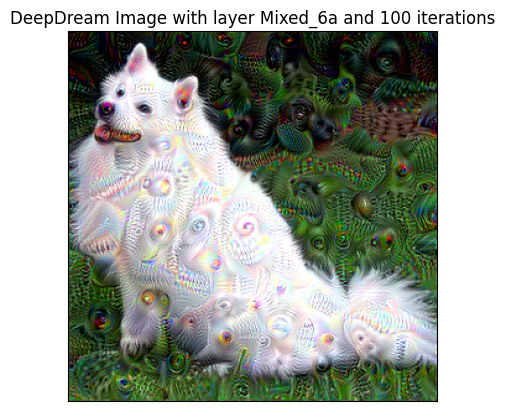

In [27]:
# Define the DeepDream function with the 'by hand' method
def deepdream(img, iterations=100, lr=0.01, tqdm_active=True):
    """
    This function performs gradient ascent on the given image for the given number of iterations using the 'by hand' method

    Args:
        img (tensor): The image to be optimised
        iterations (int): The number of iterations to optimise for
        lr (float): The learning rate
        tqdm_active (bool): Whether to use tqdm or not (default: True)
    
    Returns:
        img (tensor): The optimised image
    """
    
    # Optimizer
    optimizer = torch.optim.SGD([img.requires_grad_()], lr=lr)

    # Perform gradient ascent for the given number of iterations
    if tqdm_active:
        for i in tqdm(range(iterations)):
            # Zero the gradients
            optimizer.zero_grad()

            # Forward pass through the model to get the loss (L2 norm of the output)
            model(img)
            loss = torch.norm(outputs[-1], p=2)

            # Compute gradients
            loss.backward()

            # Scale gradients
            g = img.grad.data
            scale = torch.abs(g).mean()
            if scale != 0:
                g /= scale
            
            if i % 10 == 0:
                print(f"Iteration: {i} | Loss: {loss.item():.4f}")

            # Gradient ascent step
            img.data += lr * g
            
    else:
        for i in range(iterations):
            # Zero the gradients
            optimizer.zero_grad()

            # Forward pass through the model to get the loss (L2 norm of the output)
            model(img)
            loss = torch.norm(outputs[-1], p=2)

            # Compute gradients
            loss.backward()

            # Scale gradients
            g = img.grad.data
            scale = torch.abs(g).mean()
            if scale != 0:
                g /= scale

            # Gradient ascent step
            img.data += lr * g
            
    
    # Remove the hook
    h.remove()

    return img

# Reset the model and input image   
input_batch, model, h, outputs = reset_params(layer="Mixed_6a")
# Run DeepDream on the input image
dream_img = deepdream(input_batch, iterations=100, lr=0.01)
# Unprocess the image
output_img = unprocessed(dream_img)

# Display the image
plt.imshow(output_img)
plt.title("DeepDream Image with layer Mixed_6a and 100 iterations")
plt.xticks([])
plt.yticks([])
plt.show()

> As expected, we notice that the loss is increasing as we perform gradient ascent on the input image. This is because we are maximizing the values of the activations, which means that we are enhancing the image with the patterns and textures that the neural network has learned to recognize at that layer. After 100 iterations, we already obtain a visually striking DeepDream image that reveals the inner workings of the neural network.

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/100 [00:00<?, ?it/s]

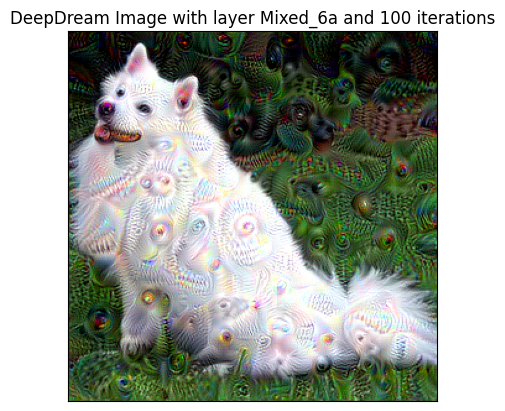

In [28]:
def deepdream_optimizer(img, iterations, lr, tqdm_active=True):
    """
    This function performs gradient ascent on the given image for the given number of iterations using the 'optimizer' method

    Args:
        img (tensor): The image to be optimised
        iterations (int): The number of iterations to optimise for
        lr (float): The learning rate
        tqdm_active (bool): Whether to use tqdm or not (default: True)
    
    Returns:
        img (tensor): The optimised image
    """

    # Define the optimizer
    optimizer = torch.optim.SGD([img.requires_grad_()], lr=lr)

    # Perform gradient ascent for the given number of iterations
    if tqdm_active:
        for i in tqdm(range(iterations)):
            optimizer.zero_grad()

            # Forward pass through the model to get the loss (L2 norm of the output)
            model(img)
            loss = torch.norm(outputs[-1])

            # Compute the gradients and scale by their absolute average
            loss.backward()
            avg_grad = torch.abs(img.grad).mean()
            img.grad /= -avg_grad

            # Gradient ascent step
            optimizer.step()

    else:
        for i in range(iterations):
            optimizer.zero_grad()

            # Forward pass through the model to get the loss (L2 norm of the output)
            model(img)
            loss = torch.norm(outputs[-1])

            # Compute the gradients and scale by their absolute average
            loss.backward()
            avg_grad = torch.abs(img.grad).mean()
            img.grad /= -avg_grad

            # Gradient ascent step
            optimizer.step()
    
    # Remove the hook
    h.remove()

    return img

# Reset the model and input image   
input_batch, model, h, outputs = reset_params(layer="Mixed_6a")
# Run DeepDream on the input image
dream_img = deepdream_optimizer(input_batch, iterations=100, lr=0.01)
# Unprocess the image
output_img_optimiser = unprocessed(dream_img)

# Display the image
plt.imshow(output_img_optimiser)
plt.title("DeepDream Image with layer Mixed_6a and 100 iterations")
plt.xticks([])
plt.yticks([])
plt.show()

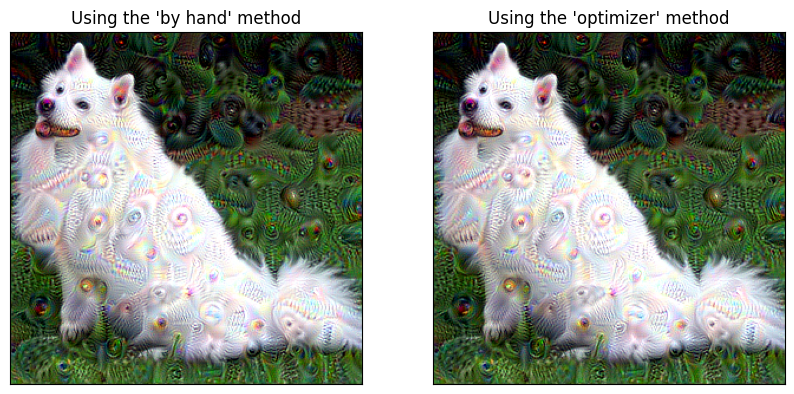

In [29]:
# Print both pictures side by side (generated using two different methods)
fig, ax = plt.subplots(1, 2, figsize=(10, 5))
ax[0].imshow(output_img)
ax[0].set_title("Using the 'by hand' method")
ax[0].set_xticks([])
ax[0].set_yticks([])
ax[1].imshow(output_img_optimiser)
ax[1].set_title("Using the 'optimiser' method")
ax[1].set_xticks([])
ax[1].set_yticks([])
plt.show()

We have successfully implemented the deepdream optimisation loop as we have been able to obtain 'dreamy' images as we could have expected. By performing gradient ascent on the L2 norm of our images, we have been able to enhance our images with the patterns and textures that the neural network has learned to recognize at that layer.

> Both methods give us the same result. However, we will be using the 'by hand' method in the next tasks as it is more intuitive, more tractable and easier to understand.

#### Task 5: Present comparisons of outputs

The impact of using different layers and the number of optimisation steps in the DeepDream method can be significant. The layer choice will affect the features that are emphasised and the overall appearance of the generated image, while the number of optimisation steps will determine the level of detail and complexity in the final image.

We will investigate in more details how the output images evolves when we changes the hooked layers and the number of optimisation steps. We will use the 'by hand' method to implement the deepdream optimisation loop.

In [30]:
layers = ['Mixed_7c', 'Mixed_6e', 'Mixed_6d', 'Mixed_6c', 'Mixed_6b', 'Mixed_6a', 'Mixed_5b']
opti_steps = [50, 100, 200, 500]
store_images = []
for layer in tqdm(layers):
    for step in opti_steps:
        input_batch, model, h, outputs = reset_params(layer)
        dream_img = deepdream(input_batch, iterations=step, lr=0.01, tqdm_active=False)
        output_img = unprocessed(dream_img)
        store_images.append(output_img)

  0%|          | 0/7 [00:00<?, ?it/s]

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cac

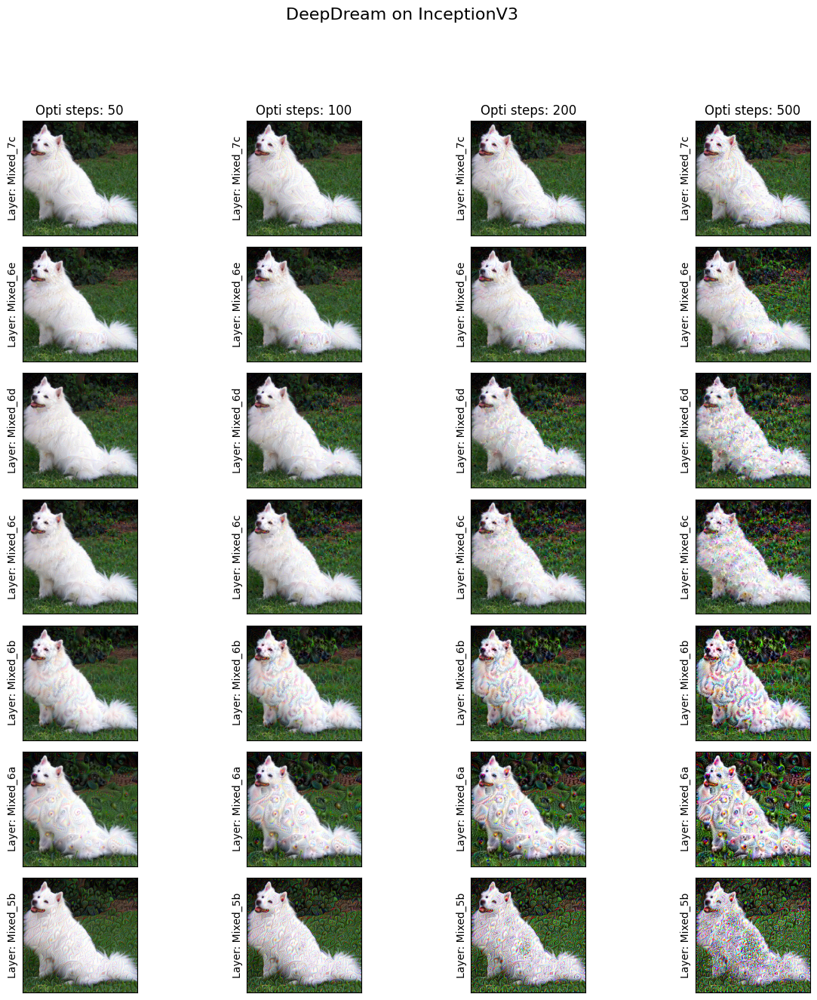

In [31]:
# Display all images as a grid
fig, axs = plt.subplots(7, 4, figsize=(15, 15))
# Reduce whitespace between images
fig.subplots_adjust(hspace=0.1, wspace=0.1)
# Add legend to the plot
for i in range(7):
    for j in range(4):
        axs[i, j].imshow(store_images[i*4+j])
        axs[i, j].set_ylabel("Layer: "+str(layers[i]))
        axs[i, j].set_xticks([])
        axs[i, j].set_yticks([])
        if i==0:
            axs[i, j].set_title("Opti steps: "+str(opti_steps[j]))
        
# Set title
fig.suptitle('DeepDream on InceptionV3', fontsize=16)
plt.show()

> We notice that different layers capture different features and patterns in our image. Lower layers capture more basic features such as edges and textures, while higher layers capture more complex features. The layer 'Mixed_6a' seems to be close to what we would expect to be a good DeepDream image.

In [32]:
layer = 'Mixed_6a'
opti_steps = np.linspace(10, 1000, 20, dtype=int)
store_images = []
for step in tqdm(opti_steps):
    input_batch, model, h, outputs = reset_params(layer)
    dream_img = deepdream(input_batch, iterations=step, lr=0.01, tqdm_active=False)
    output_img = unprocessed(dream_img)
    store_images.append(output_img)

  0%|          | 0/20 [00:00<?, ?it/s]

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0
Using cache found in /Users/yanis/.cac

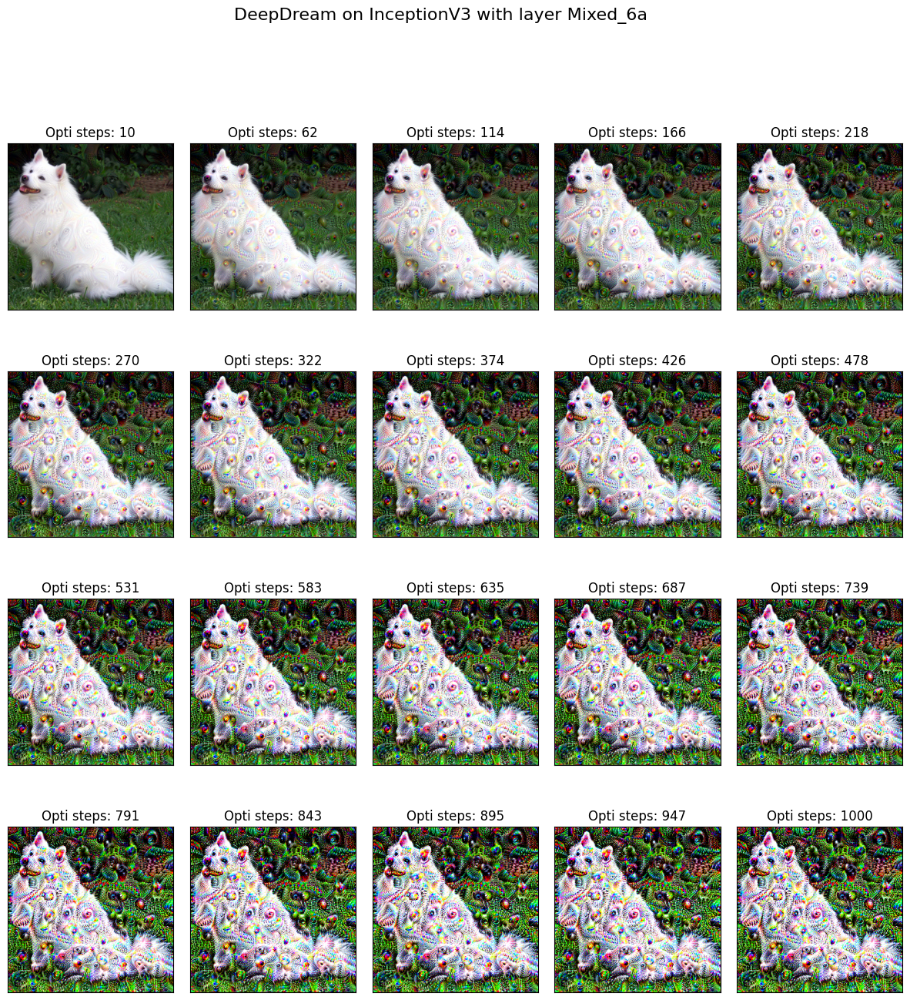

In [33]:
# Display the images as a grid
fig, axs = plt.subplots(4, 5, figsize=(15, 15))
# reduce whitespace between images
fig.subplots_adjust(hspace=0.1, wspace=0.1) 
for i in range(4):
    for j in range(5):
        axs[i, j].imshow(store_images[i*5+j])
        axs[i, j].set_xticks([])
        axs[i, j].set_yticks([])
        axs[i, j].set_title("Opti steps: "+str(opti_steps[i*5+j]))

# set title
fig.suptitle(f"DeepDream on InceptionV3 with layer {layer}", fontsize=16)
plt.show()


By plotting our images, we can see that the output images are very different depending on the layer that we use and the number of iterations that we perform.

When choosing different layers, it is important to consider the level of abstraction of the features in the layer. Lower layers in the neural network captured simple features such as edges and shapes, while higher layers captured more complex features such as textures and patterns. Therefore, using a lower layer resulted in an image that is more abstract and has more simplistic features, while using a higher layer led to a more detailed and intricate image.

The number of optimisation steps is also important, as it determines how much the image is transformed by the DeepDream method. A small number of steps resulted in an image that is only slightly different from the original input, while a larger number of steps completely transformed the image into something almost unrecognisable (or distorted). Therefore, the number of steps should be chosen based on the desired level of transformation and complexity in the final image.

Overall, experimenting with different layer choices and number of optimisation steps can lead to a wide range of interesting and unique results with the DeepDream method.

#### Task 6: Improve the results by allowing to optimise for multiple layer activations

We will now try to improve our results by optimising for multiple layers at the same time. We will use the 'by hand' method to implement the deepdream optimisation loop. 

In [34]:
# Define the DeepDream function for multiple layers
def deepdream_layers(img, iterations, lr):
    # Define the optimizer
    optimizer = torch.optim.SGD([img.requires_grad_()], lr=lr)

    # Perform gradient ascent for the given number of iterations
    for i in tqdm(range(iterations)):
        # Zero the gradients
        optimizer.zero_grad()

        # Forward pass through the model to get the loss (L2 norm of the output)
        model(img)
        
        # Compute the loss for each layer
        loss = 0
        for output in outputs[-len(layers):]:
            loss += torch.norm(output, p=2)

        # Compute gradients
        loss.backward()

        # Scale gradients
        g = img.grad.data
        scale = torch.abs(g).mean()
        if scale != 0:
            g /= scale

        # Gradient ascent step
        img.data += lr * g

        if i % 10 == 0:
            print(f"Loss at iteration {i}: {loss.item()}")
       
    # Remove the hook
    h.remove()
    return img

> Note that we have chosen to sum the L2 norm of the activations of the different layers before performing the gradient ascent step. We could also have chosen to take multiple gradient ascent steps for each layer, but we would still have obtained very similar results.

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/200 [00:00<?, ?it/s]

Loss at iteration 0: 1523.72119140625
Loss at iteration 10: 2115.019775390625
Loss at iteration 20: 2406.6728515625
Loss at iteration 30: 2603.660888671875
Loss at iteration 40: 2758.028564453125
Loss at iteration 50: 2884.210205078125
Loss at iteration 60: 2991.04736328125
Loss at iteration 70: 3082.165771484375
Loss at iteration 80: 3166.62451171875
Loss at iteration 90: 3241.48681640625
Loss at iteration 100: 3309.1376953125
Loss at iteration 110: 3373.208984375
Loss at iteration 120: 3431.400390625
Loss at iteration 130: 3487.987060546875
Loss at iteration 140: 3539.510498046875
Loss at iteration 150: 3588.805908203125
Loss at iteration 160: 3636.18017578125
Loss at iteration 170: 3682.52099609375
Loss at iteration 180: 3725.76171875
Loss at iteration 190: 3767.78125


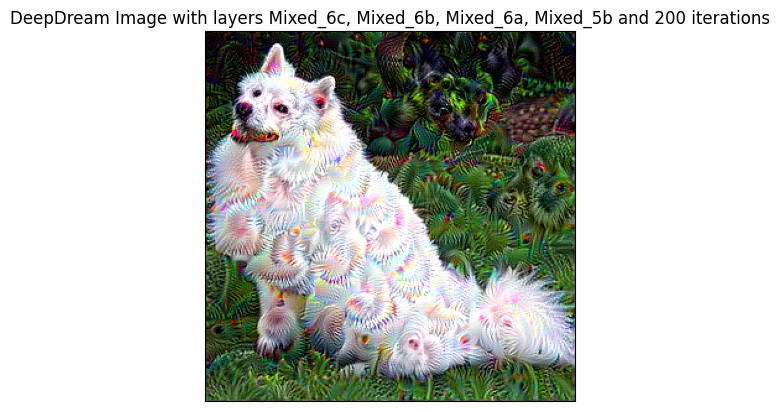

In [35]:
layers = ['Mixed_6c', 'Mixed_6b', 'Mixed_6a', 'Mixed_5b']

# Reset the model and input image
input_batch, model, h, outputs = reset_params(layers)
# Run DeepDream on the input image
dream_img = deepdream_layers(input_batch, iterations=200, lr=0.01)
# Unprocess the image
output_img = unprocessed(dream_img)
# Display the image
plt.imshow(output_img)
plt.title("DeepDream Image with layers Mixed_6c, Mixed_6b, Mixed_6a, Mixed_5b and 200 iterations")
plt.xticks([])
plt.yticks([])
plt.show()

We have used multiple layers to optimise for the activations of the input image. We have found that the results are more interesting and more varied than when we only optimised for the activations of a single layer. We can notice that different patterns and textures are emphasised in the image at the same time and this is translated into a more complex and detailed 'dreamy' image.

#### Task 7: Play around with the model and create your own dream

In this task, we are tasked to play around with the model and to create our own dream with an image of our choice. We will use the same pipeline as before, and using multiple layers as this gives us better results. We have decided to choose multiple different images to play with our model and to see the different results we can obtain.

The main theme of our images is still **ANIMALS**. Some images are real pictures of animals, while others are more abstract and where generated using [Bing Image Creator](https://www.bing.com/create), which is a DALL-E model used to generate creative images based on a textual prompt. In particular, some of the real images are extracted from the past competition of the 'Wildlife Photographer of the Year'. This competition is organised by the Natural History Museum in London and is one of the most prestigious wildlife photography competitions in the world. I would highly recommend visiting their exposition which is 2 minutes away from Imperial College London Campus! 

The prompts used for the Bing Image Creator are the following:
 - 'A crocodile on a motorcycle with a leather jacket'
 - 'A portrait of an elephant in a tuxedo'


Thus, we have chosen the following images:

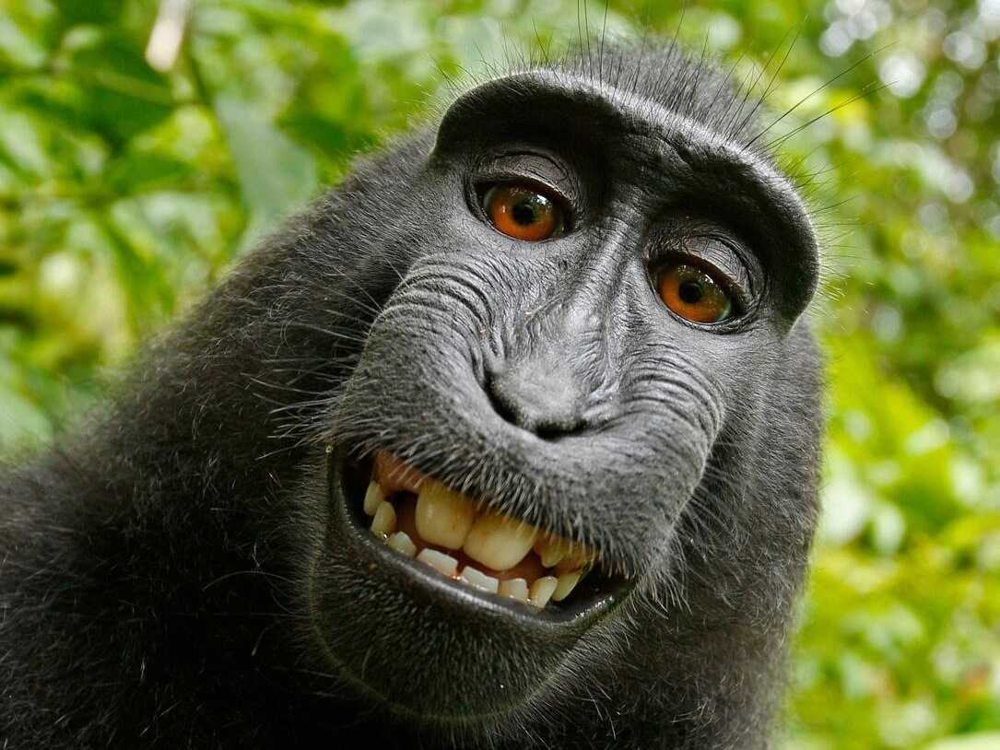

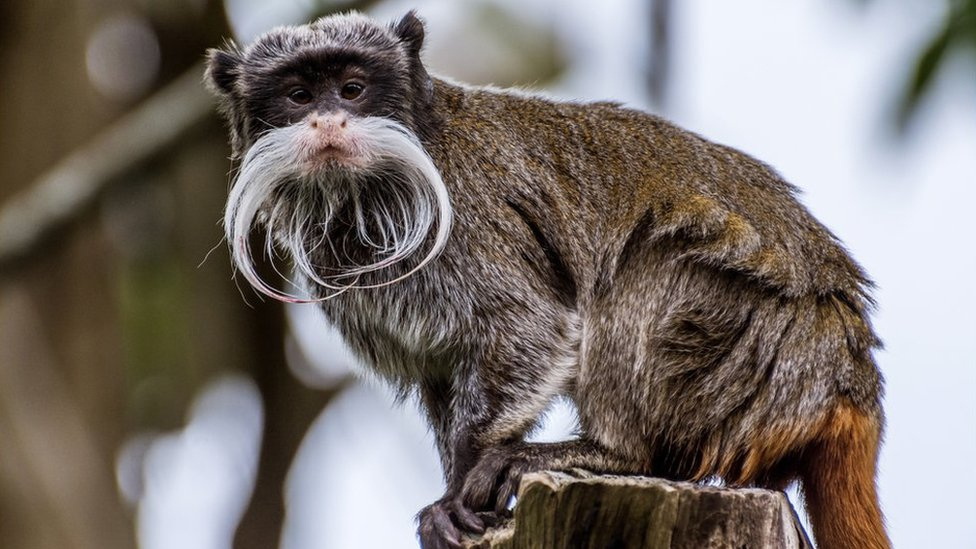

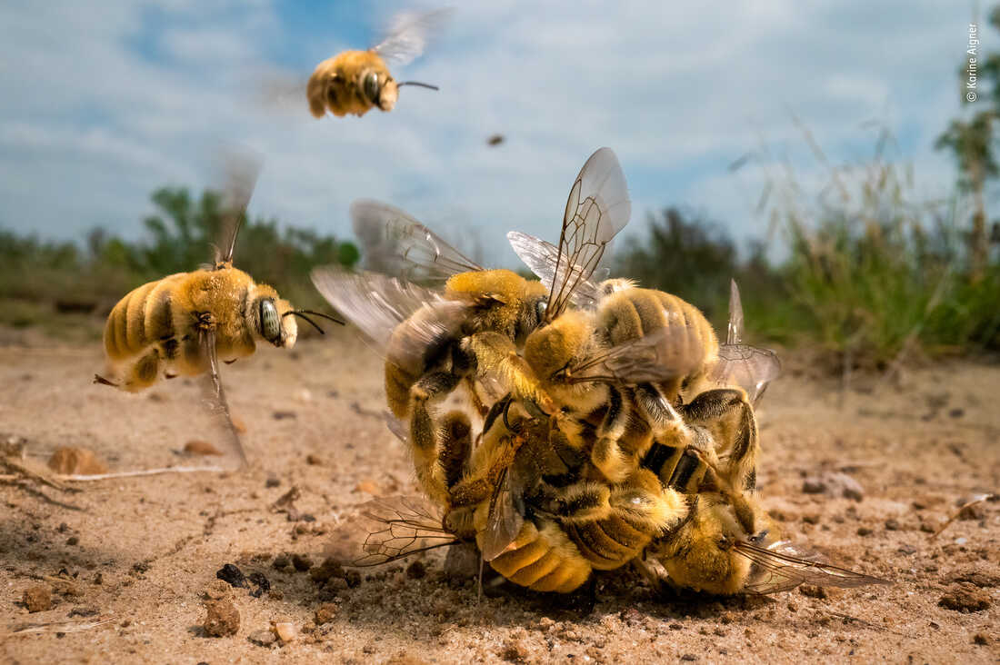

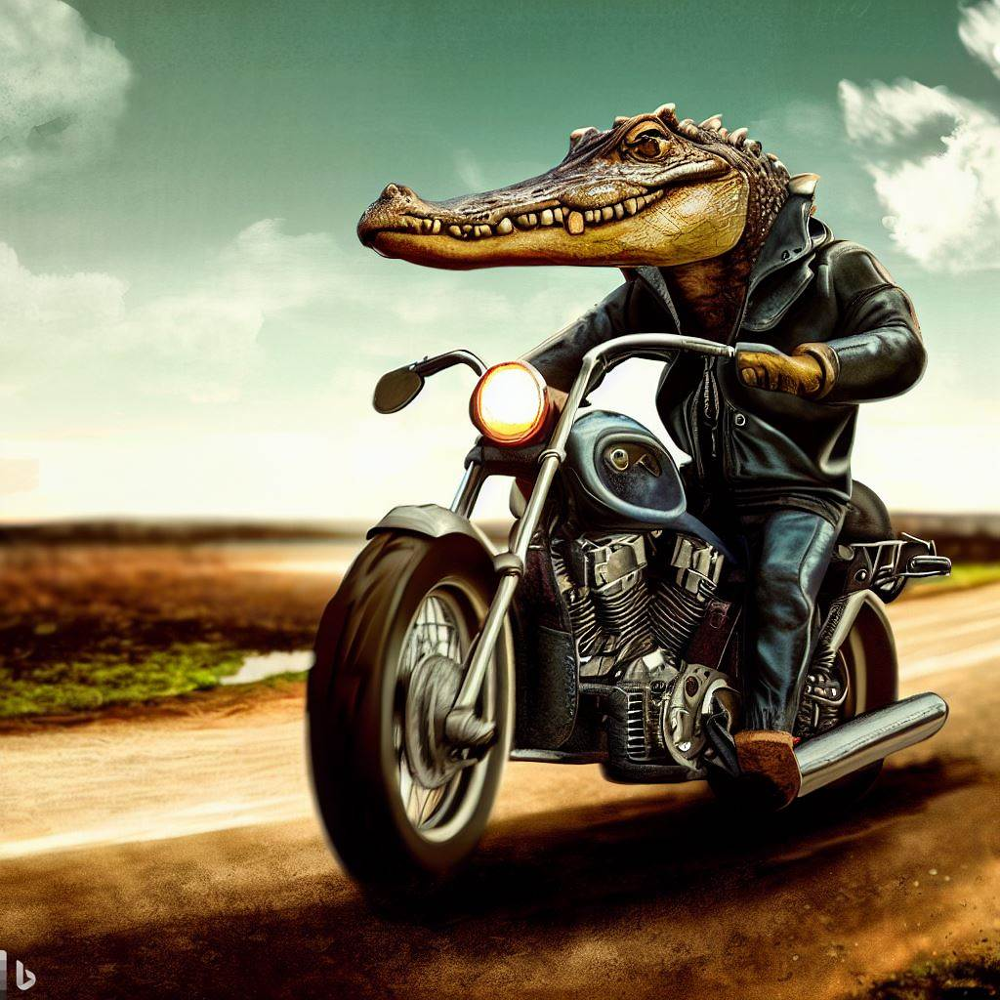

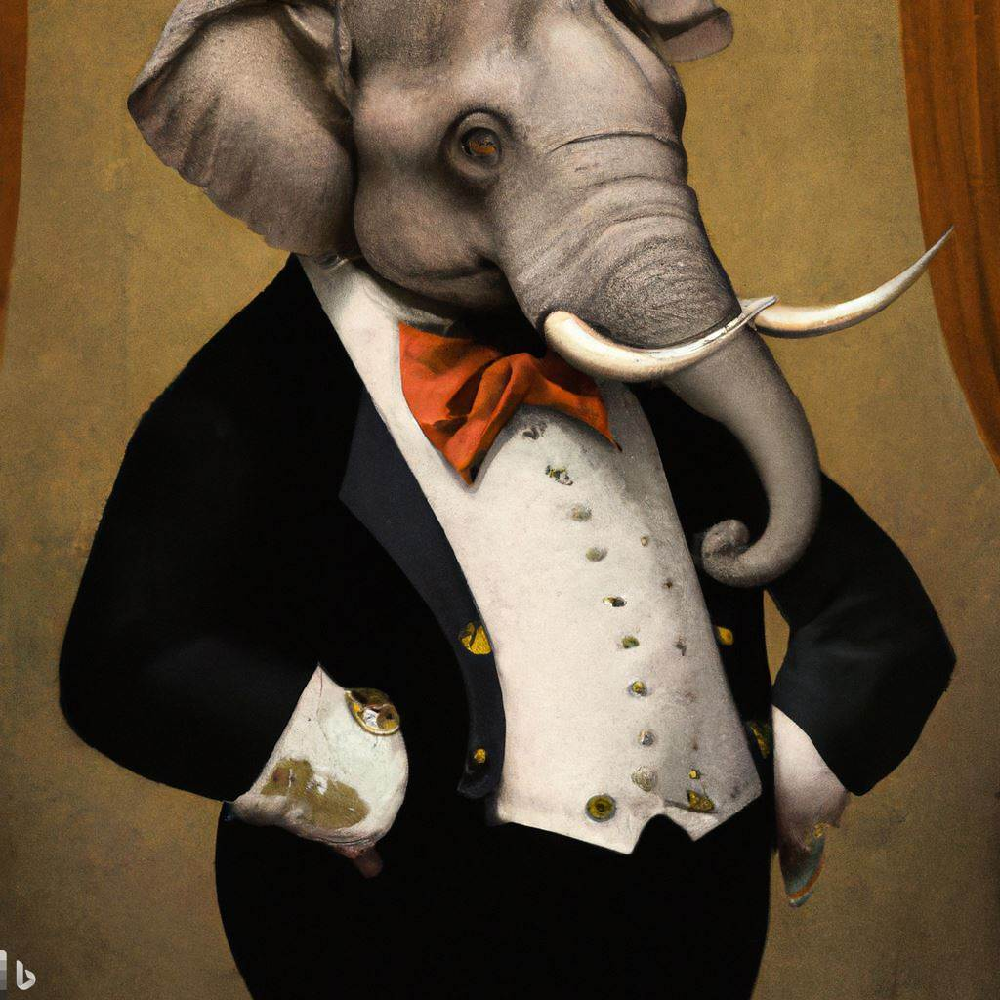

In [36]:
# Load own image
images = ["monkey.jpg", "monkey2.jpeg", "wildphotoaward.jpeg", "crocodile_bike.jpeg", "elephant_tuxedo.jpeg"]
          
for image in images:
    input_image = Image.open(image)
    input_tensor = preprocess(input_image)
    input_tensor = input_tensor.to(device)
    input_batch = input_tensor.unsqueeze(0) # create a mini-batch as expected by the model

    # Print inital image but rotated
    display.display(Image.fromarray(np.array(input_image)))
    

We can now generate the DeepDreem version of the images :

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/200 [00:00<?, ?it/s]

Loss at iteration 0: 1357.4017333984375
Loss at iteration 10: 1749.723876953125
Loss at iteration 20: 1967.629150390625
Loss at iteration 30: 2130.874267578125
Loss at iteration 40: 2264.00048828125
Loss at iteration 50: 2378.904296875
Loss at iteration 60: 2481.564697265625
Loss at iteration 70: 2573.54931640625
Loss at iteration 80: 2656.56005859375
Loss at iteration 90: 2731.11669921875
Loss at iteration 100: 2798.49169921875
Loss at iteration 110: 2861.64501953125
Loss at iteration 120: 2919.43896484375
Loss at iteration 130: 2974.4794921875
Loss at iteration 140: 3026.45849609375
Loss at iteration 150: 3074.88818359375
Loss at iteration 160: 3121.3173828125
Loss at iteration 170: 3165.265380859375
Loss at iteration 180: 3207.14013671875
Loss at iteration 190: 3247.27294921875


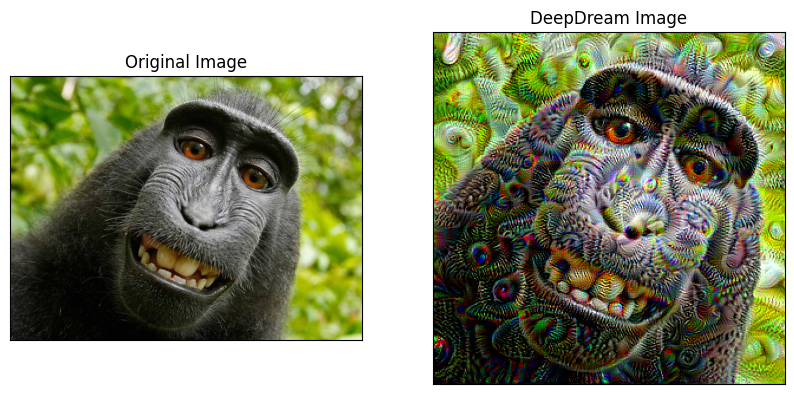

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/200 [00:00<?, ?it/s]

Loss at iteration 0: 1363.74609375
Loss at iteration 10: 1745.059814453125
Loss at iteration 20: 1962.0458984375
Loss at iteration 30: 2120.11669921875
Loss at iteration 40: 2243.482666015625
Loss at iteration 50: 2345.50634765625
Loss at iteration 60: 2433.48193359375
Loss at iteration 70: 2510.37353515625
Loss at iteration 80: 2580.98046875
Loss at iteration 90: 2644.279541015625
Loss at iteration 100: 2702.18115234375
Loss at iteration 110: 2755.644775390625
Loss at iteration 120: 2804.68701171875
Loss at iteration 130: 2850.808837890625
Loss at iteration 140: 2893.744873046875
Loss at iteration 150: 2934.8486328125
Loss at iteration 160: 2973.20068359375
Loss at iteration 170: 3011.82568359375
Loss at iteration 180: 3048.282958984375
Loss at iteration 190: 3083.9423828125


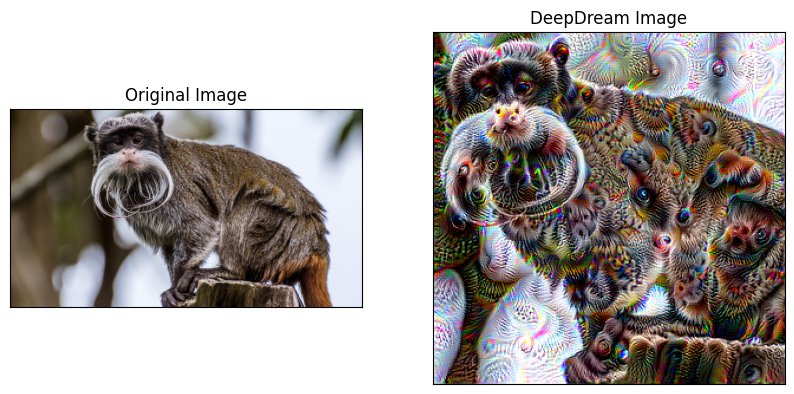

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/200 [00:00<?, ?it/s]

Loss at iteration 0: 1339.3743896484375
Loss at iteration 10: 1764.90673828125
Loss at iteration 20: 1985.056640625
Loss at iteration 30: 2132.33056640625
Loss at iteration 40: 2245.441650390625
Loss at iteration 50: 2334.1103515625
Loss at iteration 60: 2412.42529296875
Loss at iteration 70: 2481.355224609375
Loss at iteration 80: 2542.884521484375
Loss at iteration 90: 2597.136962890625
Loss at iteration 100: 2649.1142578125
Loss at iteration 110: 2695.828125
Loss at iteration 120: 2737.27734375
Loss at iteration 130: 2781.53125
Loss at iteration 140: 2822.440185546875
Loss at iteration 150: 2860.303466796875
Loss at iteration 160: 2897.316650390625
Loss at iteration 170: 2933.100341796875
Loss at iteration 180: 2967.39697265625
Loss at iteration 190: 2999.4013671875


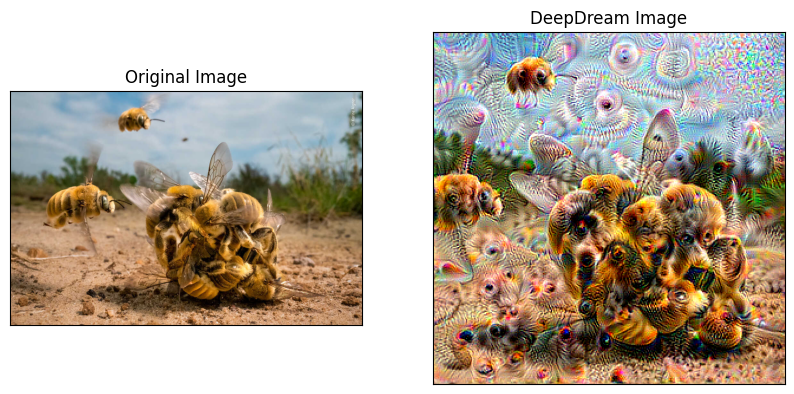

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/200 [00:00<?, ?it/s]

Loss at iteration 0: 1396.2593994140625
Loss at iteration 10: 1776.132568359375
Loss at iteration 20: 1983.7996826171875
Loss at iteration 30: 2132.883056640625
Loss at iteration 40: 2256.023681640625
Loss at iteration 50: 2359.3212890625
Loss at iteration 60: 2448.03271484375
Loss at iteration 70: 2525.760498046875
Loss at iteration 80: 2594.90380859375
Loss at iteration 90: 2658.01318359375
Loss at iteration 100: 2716.828369140625
Loss at iteration 110: 2771.46240234375
Loss at iteration 120: 2822.65869140625
Loss at iteration 130: 2870.277099609375
Loss at iteration 140: 2915.684814453125
Loss at iteration 150: 2958.28564453125
Loss at iteration 160: 2998.962158203125
Loss at iteration 170: 3037.80615234375
Loss at iteration 180: 3075.940185546875
Loss at iteration 190: 3112.974609375


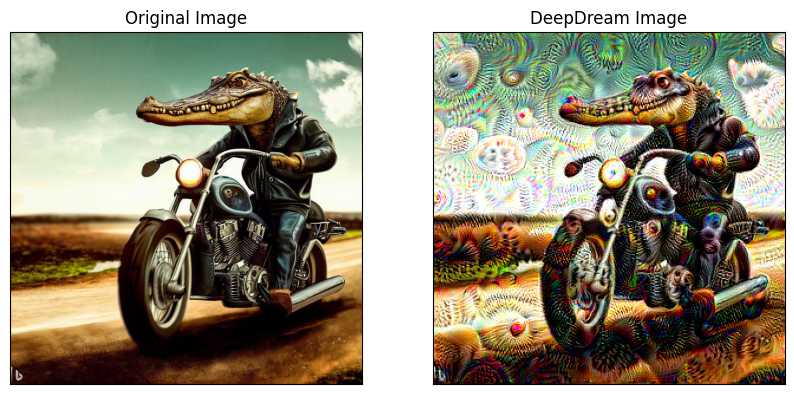

Using cache found in /Users/yanis/.cache/torch/hub/pytorch_vision_v0.10.0


  0%|          | 0/200 [00:00<?, ?it/s]

Loss at iteration 0: 1352.82421875
Loss at iteration 10: 1793.133056640625
Loss at iteration 20: 2007.270751953125
Loss at iteration 30: 2161.035888671875
Loss at iteration 40: 2281.363525390625
Loss at iteration 50: 2382.124755859375
Loss at iteration 60: 2472.511474609375
Loss at iteration 70: 2551.7900390625
Loss at iteration 80: 2623.070556640625
Loss at iteration 90: 2688.001953125
Loss at iteration 100: 2750.222900390625
Loss at iteration 110: 2807.637939453125
Loss at iteration 120: 2861.7314453125
Loss at iteration 130: 2911.064453125
Loss at iteration 140: 2957.8935546875
Loss at iteration 150: 3001.51513671875
Loss at iteration 160: 3042.92822265625
Loss at iteration 170: 3083.040283203125
Loss at iteration 180: 3121.174560546875
Loss at iteration 190: 3157.93701171875


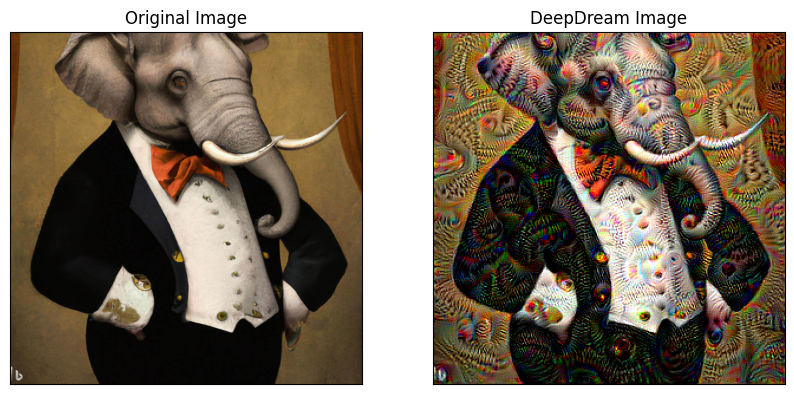

In [37]:
layers = ['Mixed_6b', 'Mixed_6a', 'Mixed_5b']

for image in images:
    input_image = Image.open(image)
    input_tensor = preprocess(input_image)
    input_tensor = input_tensor.to(device)
    input_batch = input_tensor.unsqueeze(0)
    model = torch.hub.load('pytorch/vision:v0.10.0', model='inception_v3', weights=models.Inception_V3_Weights.DEFAULT)
    model.to(device)
    model.eval()
    outputs = []
    for layer in layers:
        h = model._modules.get(layer).register_forward_hook(hook)
    dream_img = deepdream_layers(input_batch, iterations=200, lr=0.01)
    output_img = unprocessed(dream_img)
    fig, ax = plt.subplots(1, 2, figsize=(10, 5))
    ax[0].imshow(input_image)
    ax[0].set_title("Original Image")
    ax[0].set_xticks([])
    ax[0].set_yticks([])
    ax[1].imshow(output_img)
    ax[1].set_title("DeepDream Image")
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    plt.show()

After trying with different hyperparameters, we have successfully obtained 'dreamy' images! Our DeepDream model has been able to detect some patterns in our images and by using gradient ascent, we have been able to build creative (but also kind of scary 🫣) images. It has been able to correclty generate visually striking images that reveal the inner workings of the neural network.

This technique has also been used to generate interesting and artistic images. Could we be the next winners of the Wildlife Photographer of the Year with our DeepDream images? 😉 🏆

> Side note: thank you for allowing us to play with the model! I had a lot of fun to try to play with our built model with some custom images and in particular family images. 